In [1]:
import torch
from torch import nn
from torch.nn import init
from torch.utils.data import Dataset
import torchvision.transforms as transforms
import random, os, time, itertools, functools
from PIL import Image
import matplotlib.pyplot as plt
from torchvision.transforms.functional import to_pil_image,pil_to_tensor
from torch.optim import lr_scheduler
import torchvision.transforms.functional as TF
import torchvision.models as models
import numpy as np
from torch.nn import functional as F

In [2]:
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

In [3]:
from collections import OrderedDict

In [4]:
class Options():
    def __init__(self):
        self.direction = 'AtoB'
        self.datapath = '/kaggle/input/testing-data/testing_data/'
        self.crop_size = 256
        self.preprocess = 'resize_and_crop'
        self.load_size = 512
        self.no_flip = False
        self.serial_batches = True
        self.num_threads = 4
        self.batch_size = 16
        self.epoch_count = 1
        self.lr = 0.0003              
        self.lr_policy = 'linear'
        self.lr_decay_iters = 50
        self.gan_mode = 'lsgan'
#         self.lambda_A = 0.5
#         self.lambda_B = 0.5
        self.gan_loss_wt = 10
        self.cycle_loss_wt = 12
        self.idt_loss_wt = 2
        self.lambda_identity = 1
        self.pool_size = 50        
        self.n_epochs = 100
        self.n_epochs_decay = 100
        self.print_freq = 2000
        self.display_freq = 2000
        self.name = "unet_with_style_loss_7"
        self.beta1 = 0.5
        self.padding_type = 'reflect'
        self.save_freq = 10
        self.mode = 'test'

In [5]:
opt = Options()

In [6]:
def __make_power_2(img, base, method=transforms.InterpolationMode.BICUBIC):
    method = __transforms2pil_resize(method)
    ow, oh = img.size
    h = int(round(oh / base) * base)
    w = int(round(ow / base) * base)
    if h == oh and w == ow:
        return img
    return img.resize((w, h), method)

def __scale_width(img, target_size, crop_size, method=transforms.InterpolationMode.BICUBIC):
    method = __transforms2pil_resize(method)
    ow, oh = img.size
    if ow == target_size and oh >= crop_size:
        return img
    w = target_size
    h = int(max(target_size * oh / ow, crop_size))
    return img.resize((w, h), method)

def __crop(img, pos, size):
    ow, oh = img.size
    x1, y1 = pos
    tw = th = size
    if (ow > tw or oh > th):
        return img.crop((x1, y1, x1 + tw, y1 + th))
    return img

def __flip(img, flip):
    if flip:
        return img.transpose(Image.FLIP_LEFT_RIGHT)
    return img

In [7]:
def get_transform(opt, params=None, grayscale=False, method=transforms.InterpolationMode.BICUBIC, convert=True):
    transform_list = []
    if grayscale:
        transform_list.append(transforms.Grayscale(1))
    if 'resize' in opt.preprocess:
        output_size = [opt.load_size, opt.load_size]
        transform_list.append(transforms.Resize(output_size, method))
    elif 'scale_width' in opt.preprocess:
        transform_list.append(transforms.Lambda(lambda img: __scale_width(img, opt.load_size, opt.crop_size, method)))

    if 'crop' in opt.preprocess:
        if params is None:
            transform_list.append(transforms.RandomCrop(opt.crop_size))
        else:
            transform_list.append(transforms.Lambda(lambda img: __crop(img, params['crop_pos'], opt.crop_size)))

    if opt.preprocess == 'none':
        transform_list.append(transforms.Lambda(lambda img: __make_power_2(img, base=4, method=method)))

    if not opt.no_flip:
        if params is None:
            transform_list.append(transforms.RandomHorizontalFlip())
        elif params['flip']:
            transform_list.append(transforms.Lambda(lambda img: __flip(img, params['flip'])))

    if convert:
        transform_list += [transforms.ToTensor()]
        if grayscale:
            transform_list += [transforms.Normalize((0.5,), (0.5,))]
        else:
            transform_list += [transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))]
    return transforms.Compose(transform_list)

In [8]:
def show_images(tensor):
    img_titles = ['Original X', 'Reconstructed X', 'Original Y', 'Reconstrcuted Y', 'Transformed X', 'Transformed Y']
    
    #Un-Normalizing Images for visualization
    un_normalize = transforms.Compose([transforms.Normalize((-1, -1, -1), ((1/0.5), (1/0.5), (1/0.5)))])
    
    for i in range(tensor.shape[0]):
        tensor[i] = un_normalize(tensor[i])
        
    
    # Create a figure with 6 subplots in a row
    fig, axs = plt.subplots(1, 6, figsize=(18, 4))

    # Display each image in the tensor
    for i in range(tensor.shape[0]):
        img = tensor[i].permute(1, 2, 0)  # Change tensor shape to (H, W, C) for imshow
        axs[i].imshow(img)  # Display image on subplot
        axs[i].axis('off')  # Turn off axis
        axs[i].set_title(f'{img_titles[i]}')  # Set title for each subplot

    plt.tight_layout()  # Adjust layout to prevent overlapping
    plt.show()

In [9]:
class CustomDataset(Dataset):
    def __init__(self, opt):
        self.opt = opt
#         self.A_path = '/kaggle/input/image-data/data/trainA/'
#         self.B_path = '/kaggle/input/image-data/data/trainB/'
        
        self.A_path = 'data/trainA/'
        self.B_path = 'data/trainB/'
        self.transform = get_transform(self.opt)
#         if opt.direction == 'AtoB':
#             X_img_list = os.listdir(self.A_path)
#             Y_img_list = os.listdir(self.B_path)
#             self.X_img_names = [img for img in X_img_list if "txt" not in img]
#             self.Y_img_names = [img for img in Y_img_list if "txt" not in img]
#         else:
#             self.X_img_names = os.listdir(self.B_path)
#             self.Y_img_names = os.listdir(self.A_path)
            
        
        #considering only those images >= size 256 * 256
        self.X_images = []
        for img in os.listdir(self.A_path):
            if 'txt' not in img:
                image = Image.open(os.path.join(self.A_path, img)).convert('RGB')
                width, height = image.size
                if height >=800 and width >= 800:
                    self.X_images.append(self.transform(image))     
            else:
                continue
                
        self.Y_images = []
        for img in os.listdir(self.B_path):
            if 'txt' not in img:
                image = Image.open(os.path.join(self.B_path, img)).convert('RGB')
                width, height = image.size
                if height >= 800 and width >= 800:
                    self.Y_images.append(self.transform(image))
            else:
                continue
        
        random.shuffle(self.X_images)
        random.shuffle(self.Y_images)
        
        self.X_length = len(self.X_images)
        self.Y_length = len(self.Y_images)
        self.Y_images = self.Y_images[:(self.X_length)]
        self.Y_length = len(self.Y_images)
        
    def __getitem__(self, index):
        
        img_X = self.X_images[index % self.X_length]
        # randomize the index for domain B to avoid fixed pairs
        index_Y = random.randint(0, self.Y_length - 1)
        img_Y = self.Y_images[index_Y]
        return img_X, img_Y
    
    def __len__(self):
        return self.X_length + self.Y_length

In [10]:
dataset = CustomDataset(opt)

In [11]:
len(dataset)

1268

In [12]:
print(dataset.X_length, dataset.Y_length)

634 634


In [13]:
def get_norm_layer(norm_type='instance'):
    """Return a normalization layer

    Parameters:
        norm_type (str) -- the name of the normalization layer: batch | instance | none

    For BatchNorm, we use learnable affine parameters and track running statistics (mean/stddev).
    For InstanceNorm, we do not use learnable affine parameters. We do not track running statistics.
    """
    if norm_type == 'batch':
        norm_layer = functools.partial(nn.BatchNorm2d, affine=True, track_running_stats=True)
    elif norm_type == 'instance':
        norm_layer = functools.partial(nn.InstanceNorm2d, affine=False, track_running_stats=False)
    elif norm_type == 'none':
        def norm_layer(x):
            return Identity()
    else:
        raise NotImplementedError('normalization layer [%s] is not found' % norm_type)
    return norm_layer

In [14]:
class UnetSkipConnectionBlock(nn.Module):
    """Defines the Unet submodule with skip connection.
        X -------------------identity----------------------
        |-- downsampling -- |submodule| -- upsampling --|
    """

    def __init__(self, outer_nc, inner_nc, in_channels=None,
                 submodule=None, outermost=False, innermost=False, norm_layer=nn.BatchNorm2d, use_dropout=False):
        """Construct a Unet submodule with skip connections.

        Parameters:
            outer_nc (int) -- the number of filters in the outer conv layer
            inner_nc (int) -- the number of filters in the inner conv layer
            input_nc (int) -- the number of channels in input images/features
            submodule (UnetSkipConnectionBlock) -- previously defined submodules
            outermost (bool)    -- if this module is the outermost module
            innermost (bool)    -- if this module is the innermost module
            norm_layer          -- normalization layer
            use_dropout (bool)  -- if use dropout layers.
        """
        super(UnetSkipConnectionBlock, self).__init__()
        self.outermost = outermost
        if type(norm_layer) == functools.partial:
            use_bias = norm_layer.func == nn.InstanceNorm2d
        else:
            use_bias = norm_layer == nn.InstanceNorm2d
        if in_channels is None:
            in_channels = outer_nc
        downconv = nn.Conv2d(in_channels, inner_nc, kernel_size=4,
                             stride=2, padding=1, bias=use_bias)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = norm_layer(inner_nc)
        uprelu = nn.ReLU(True)
        upnorm = norm_layer(outer_nc)

        if outermost:
            upconv = nn.ConvTranspose2d(inner_nc * 2, outer_nc,
                                        kernel_size=4, stride=2,
                                        padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(inner_nc, outer_nc,
                                        kernel_size=4, stride=2,
                                        padding=1, bias=use_bias)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(inner_nc * 2, outer_nc,
                                        kernel_size=4, stride=2,
                                        padding=1, bias=use_bias)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]

            if use_dropout:
                model = down + [submodule] + up + [nn.Dropout(0.5)]
            else:
                model = down + [submodule] + up

        self.model = nn.Sequential(*model)

    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:   # add skip connections
            return torch.cat([x, self.model(x)], 1)

In [15]:
class UnetGenerator(nn.Module):
    """Create a Unet-based generator"""

    def __init__(self, in_channels, out_channels, num_downsample, last_filters, norm_type, init_type, init_gain, use_dropout):
        """Construct a Unet generator
        Parameters:
            input_nc (int)  -- the number of channels in input images
            output_nc (int) -- the number of channels in output images
            num_downs (int) -- the number of downsamplings in UNet. For example, # if |num_downs| == 7,
                                image of size 128x128 will become of size 1x1 # at the bottleneck
            ngf (int)       -- the number of filters in the last conv layer
            norm_layer      -- normalization layer

        We construct the U-Net from the innermost layer to the outermost layer.
        It is a recursive process.
        """
        super(UnetGenerator, self).__init__()
        self.init_type = init_type
        self.init_gain = init_gain
        norm_layer = get_norm_layer(norm_type=norm_type)
        # construct unet structure
        unet_block = UnetSkipConnectionBlock(last_filters * 8, last_filters * 8, in_channels=None, submodule=None, norm_layer=norm_layer, innermost=True)  # add the innermost layer
        for i in range(num_downsample - 5):          # add intermediate layers with ngf * 8 filters
            unet_block = UnetSkipConnectionBlock(last_filters * 8, last_filters * 8, in_channels=None, submodule=unet_block, norm_layer=norm_layer, use_dropout=use_dropout)
        # gradually reduce the number of filters from ngf * 8 to ngf
        unet_block = UnetSkipConnectionBlock(last_filters * 4, last_filters * 8, in_channels=None, submodule=unet_block, norm_layer=norm_layer)
        unet_block = UnetSkipConnectionBlock(last_filters * 2, last_filters * 4, in_channels=None, submodule=unet_block, norm_layer=norm_layer)
        unet_block = UnetSkipConnectionBlock(last_filters, last_filters * 2, in_channels=None, submodule=unet_block, norm_layer=norm_layer)
        self.model = UnetSkipConnectionBlock(out_channels, last_filters, in_channels=in_channels, submodule=unet_block, outermost=True, norm_layer=norm_layer)  # add the outermost layer
        self.apply(self._init_weights)
        
    def _init_weights(self,m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and (classname.find('Conv') != -1 or classname.find('Linear') != -1):
            if self.init_type == 'normal':
                init.normal_(m.weight.data, 0.0, self.init_gain)
            elif self.init_type == 'xavier':
                init.xavier_normal_(m.weight.data, gain=self.init_gain)
            elif self.init_type == 'kaiming':
                init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            elif self.init_type == 'orthogonal':
                init.orthogonal_(m.weight.data, gain=self.init_gain)
            else:
                raise NotImplementedError('initialization method [%s] is not implemented' % self.init_type)
            if hasattr(m, 'bias') and m.bias is not None:
                init.constant_(m.bias.data, 0.0)
        elif classname.find('BatchNorm2d') != -1:  # BatchNorm Layer's weight is not a matrix; only normal distribution applies.
            init.normal_(m.weight.data, 1.0, self.init_gain)
            init.constant_(m.bias.data, 0.0)
            
    def forward(self, input):
        """Standard forward"""
        return self.model(input)

In [16]:
class PatchDiscriminator(nn.Module):
    """Defines a PatchGAN discriminator"""

    def __init__(self, in_channels, last_filters, init_gain, init_type, n_layers, norm_type):
        """Construct a PatchGAN discriminator

        Parameters:
            input_nc (int)  -- the number of channels in input images
            ndf (int)       -- the number of filters in the last conv layer
            n_layers (int)  -- the number of conv layers in the discriminator
            norm_layer      -- normalization layer
        """
        super(PatchDiscriminator, self).__init__()
        norm_layer = get_norm_layer(norm_type=norm_type)
        if type(norm_layer) == functools.partial:  # no need to use bias as BatchNorm2d has affine parameters
            use_bias = norm_layer.func == nn.InstanceNorm2d
        else:
            use_bias = norm_layer == nn.InstanceNorm2d

        kw = 4
        padw = 1
        sequence = [nn.Conv2d(in_channels, last_filters, kernel_size=kw, stride=2, padding=padw), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        nf_mult_prev = 1
        for n in range(1, n_layers):  # gradually increase the number of filters
            nf_mult_prev = nf_mult
            nf_mult = min(2 ** n, 8)
            sequence += [
                nn.Conv2d(last_filters * nf_mult_prev, last_filters * nf_mult, kernel_size=kw, stride=2, padding=padw, bias=use_bias),
                norm_layer(last_filters * nf_mult),
                nn.LeakyReLU(0.2, True)
            ]

        nf_mult_prev = nf_mult
        nf_mult = min(2 ** n_layers, 8)
        sequence += [
            nn.Conv2d(last_filters * nf_mult_prev, last_filters * nf_mult, kernel_size=kw, stride=1, padding=padw, bias=use_bias),
            norm_layer(last_filters * nf_mult),
            nn.LeakyReLU(0.2, True)
        ]

        sequence += [nn.Conv2d(last_filters * nf_mult, 1, kernel_size=kw, stride=1, padding=padw)]  # output 1 channel prediction map
        self.model = nn.Sequential(*sequence)

    def forward(self, input):
        """Standard forward."""
        return self.model(input)

In [17]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode, target_real_label=1.0, target_fake_label=0.0):
        super(GANLoss, self).__init__()
        self.register_buffer('real_label', torch.tensor(target_real_label))
        self.register_buffer('fake_label', torch.tensor(target_fake_label))
        self.gan_mode = gan_mode
        if gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
        elif gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode in ['wgangp']:
            self.loss = None
        else:
            raise NotImplementedError('gan mode %s not implemented' % gan_mode)

    def get_target_tensor(self, prediction, target_is_real):
        if target_is_real:
            target_tensor = self.real_label
        else:
            target_tensor = self.fake_label
        return target_tensor.expand_as(prediction)

    def __call__(self, prediction, target_is_real):
        if self.gan_mode in ['lsgan', 'vanilla']:
            target_tensor = self.get_target_tensor(prediction, target_is_real)
            loss = self.loss(prediction, target_tensor)
        elif self.gan_mode == 'wgangp':
            if target_is_real:
                loss = -prediction.mean()
            else:
                loss = prediction.mean()
        return loss

In [18]:
# class ImagePool():
#     def __init__(self, pool_size):
#         self.pool_size = pool_size
#         if self.pool_size > 0:  # create an empty pool
#             self.num_imgs = 0
#             self.images = []

#     def query(self, images):
#         if self.pool_size == 0:  # if the buffer size is 0, do nothing
#             return images
#         return_images = []
#         for image in images:
#             image = torch.unsqueeze(image.data, 0)
#             if self.num_imgs < self.pool_size:   # if the buffer is not full; keep inserting current images to the buffer
#                 self.num_imgs = self.num_imgs + 1
#                 self.images.append(image)
#                 return_images.append(image)
#             else:
#                 p = random.uniform(0, 1)
#                 if p > 0.5:  # by 50% chance, the buffer will return a previously stored image, and insert the current image into the buffer
#                     random_id = random.randint(0, self.pool_size - 1)  # randint is inclusive
#                     tmp = self.images[random_id].clone()
#                     self.images[random_id] = image
#                     return_images.append(tmp)
#                 else:       # by another 50% chance, the buffer will return the current image
#                     return_images.append(image)
#         return_images = torch.cat(return_images, 0)   # collect all the images and return
#         return return_images

In [19]:
# create a logging file to store training losses
# log_name = '/kaggle/working/' + opt.name + 'loss_log.txt'
log_name = opt.name + 'loss_log.txt'
with open(log_name, "a+") as log_file:
    now = time.strftime("%c")
    log_file.write('================ Training Loss (%s) ================\n' % now)

# losses: same format as |losses| of plot_current_losses
def print_current_losses(epoch, iters, losses, t_comp, t_data):
    """print current losses on console; also save the losses to the disk

    Parameters:
        epoch (int) -- current epoch
        iters (int) -- current training iteration during this epoch (reset to 0 at the end of every epoch)
        losses (OrderedDict) -- training losses stored in the format of (name, float) pairs
        t_comp (float) -- computational time per data point (normalized by batch_size)
        t_data (float) -- data loading time per data point (normalized by batch_size)
    """
    message = '(epoch: %d, iters: %d, time: %.3f, data: %.3f) ' % (epoch, iters, t_comp, t_data)
    for k, v in losses.items():
        message += '%s: %.3f ' % (k, v)

    print(message)  # print the message
    with open(log_name, "a") as log_file:
        log_file.write('%s\n' % message)  # save the message

In [20]:
def update_learning_rate(self):
        """Update learning rates for all the networks; called at the end of every epoch"""
        old_lr = self.optimizers[0].param_groups[0]['lr']
        for scheduler in self.schedulers:
            if self.opt.lr_policy == 'plateau':
                scheduler.step(self.metric)
            else:
                scheduler.step()

        lr = self.optimizers[0].param_groups[0]['lr']
        print('learning rate %.7f -> %.7f' % (old_lr, lr))

In [21]:
vgg = models.vgg16(weights = None)

In [22]:
vgg.load_state_dict(torch.load("./vgg16-pretrained.pth"))
vgg = vgg.features
vgg.eval()

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (17): Conv2d(256, 512, kernel_si

In [23]:
def get_vgg_model(vgg, style_layers):
  

    model = nn.Sequential()

    i = 0  # increment every time we see a conv
    for layer in vgg.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        model.add_module(name, layer)


        if name in style_layers:
            break      
        
                                                                                       
        
    print(model)

    return model


In [24]:
class CycleGAN(nn.Module):
    def __init__(self, opt):
        super(CycleGAN, self).__init__()
        
        self.opt = opt
        
        self.style_layers_select = ['conv_9']
        self.style_layer_wt = {'conv_9':1}
        self.loss_names = ['D_Y', 'G_XY_basic', 'style_G_XY', 'cycle_X', 'idt_X', 'D_X', 'G_YX_basic','style_G_YX', 'cycle_Y', 'idt_Y']
        self.optimizers = []
        
        #implements function G : X -> Y
        self.G_XY = UnetGenerator(in_channels=3,out_channels=3,num_downsample=8,last_filters=64,norm_type='instance',init_type='normal',init_gain=0.02,use_dropout=False).to('cuda:0')
        #implements function F: Y -> X
        self.G_YX = UnetGenerator(in_channels=3,out_channels=3,num_downsample=8,last_filters=64,norm_type='instance',init_type='normal',init_gain=0.02,use_dropout=False).to('cuda:0')
        
        #implements discriminator to classify real_Y from fake_Y
        self.D_Y = PatchDiscriminator(in_channels=3, last_filters=64, init_gain=0.02, init_type='normal', n_layers=3, norm_type='instance').to('cuda:0')
        #implements discriminator to classify real_X from fake_X
        self.D_X = PatchDiscriminator(in_channels=3, last_filters=64, init_gain=0.02, init_type='normal', n_layers=3, norm_type='instance').to('cuda:0')
        
        #VGG Models
        self.VGG_models = []
        for i in self.style_layers_select:
            self.VGG_models.append(get_vgg_model(vgg, style_layers = i).to('cuda:0'))
        
#         self.fake_Y_pool = ImagePool(opt.pool_size) # create image buffer to store previously generated images
#         self.fake_X_pool = ImagePool(opt.pool_size)  # create image buffer to store previously generated images
        
        sub_model = [self.G_XY,self.G_YX,self.D_Y,self.D_X]
        for element in sub_model:
            print(f"**********MODEL***********")
            print(element)
        
        # define loss functions
        self.criterionGAN = GANLoss(opt.gan_mode)  # define GAN loss.
        self.criterionCycle = torch.nn.L1Loss()
        self.criterionIdt = torch.nn.L1Loss()
        
        # initialize optimizers
        self.optimizer_G = torch.optim.Adam(itertools.chain(self.G_XY.parameters(), self.G_YX.parameters()), lr=opt.lr, betas=(opt.beta1, 0.999))
        self.optimizer_D = torch.optim.Adam(itertools.chain(self.D_Y.parameters(), self.D_X.parameters()), lr=opt.lr, betas=(opt.beta1, 0.999))
        self.optimizers.append(self.optimizer_G)
        self.optimizers.append(self.optimizer_D)
        self.schedulers = [self.get_scheduler(optimizer, opt) for optimizer in self.optimizers]
        
    def get_scheduler(self, optimizer, opt):
        """Return a learning rate scheduler

        Parameters:
            optimizer          -- the optimizer of the network
            opt (option class) -- stores all the experiment flags; needs to be a subclass of BaseOptions．　
                                  opt.lr_policy is the name of learning rate policy: linear | step | plateau | cosine

        For 'linear', we keep the same learning rate for the first <opt.n_epochs> epochs
        and linearly decay the rate to zero over the next <opt.n_epochs_decay> epochs.
        For other schedulers (step, plateau, and cosine), we use the default PyTorch schedulers.
        See https://pytorch.org/docs/stable/optim.html for more details.
        """
        if opt.lr_policy == 'linear':
            def lambda_rule(epoch):
                lr_l = 1.0 - max(0, epoch + opt.epoch_count - opt.n_epochs) / float(opt.n_epochs_decay + 1)
                return lr_l
            scheduler = lr_scheduler.LambdaLR(optimizer, lr_lambda=lambda_rule)
        elif opt.lr_policy == 'step':
            scheduler = lr_scheduler.StepLR(optimizer, step_size=opt.lr_decay_iters, gamma=0.1)
        elif opt.lr_policy == 'plateau':
            scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.2, threshold=0.01, patience=5)
        elif opt.lr_policy == 'cosine':
            scheduler = lr_scheduler.CosineAnnealingLR(optimizer, T_max=opt.n_epochs, eta_min=0)
        else:
            return NotImplementedError('learning rate policy [%s] is not implemented', opt.lr_policy)
        return scheduler        
    
    def update_learning_rate(self):
        """Update learning rates for all the networks; called at the end of every epoch"""
        old_lr = self.optimizers[0].param_groups[0]['lr']
        for scheduler in self.schedulers:
            if self.opt.lr_policy == 'plateau':
                scheduler.step(self.metric)
            else:
                scheduler.step()

        lr = self.optimizers[0].param_groups[0]['lr']
#         print('learning rate %.7f -> %.7f' % (old_lr, lr))

    def gram_matrix(self, input_image_Fmap):
        batch_size, num_channels, height, width = input_image_Fmap.size()
        gram_matrices = []

        for i in range(batch_size):
            features = input_image_Fmap[i].view(num_channels, height * width)
            gram_matrix_i = torch.mm(features, features.t())
            # Normalize the Gram matrix
            gram_matrix_i = gram_matrix_i.div(num_channels * height * width)
            gram_matrices.append(gram_matrix_i)

        # Stack the Gram matrices along a new dimension to create a single 3D tensor
        gram_matrices = torch.stack(gram_matrices, dim=0)

        return gram_matrices
        
    def forward(self, real_X, real_Y):
        self.real_X = real_X.to('cuda:0')
        self.real_Y = real_Y.to('cuda:0')
        
        self.fake_Y = self.G_XY(self.real_X).to('cuda:0')   #finding G(X)
        self.rec_X = self.G_YX(self.fake_Y).to('cuda:0')    #finding F(G(X))
        
        self.fake_X = self.G_YX(self.real_Y).to('cuda:0')   #finding F(Y)
        self.rec_Y = self.G_XY(self.fake_X).to('cuda:0')   #finding G(F(Y))
        
        return (self.fake_Y,self.fake_X,self.rec_X, self.rec_Y)
        
    def set_requires_grad(self, nets, requires_grad=False):
        """Set requies_grad=False for all the networks to avoid unnecessary computations
        Parameters:
            nets (network list)   -- a list of networks
            requires_grad (bool)  -- whether the networks require gradients or not
        """
        if not isinstance(nets, list):
            nets = [nets]
        for net in nets:
            if net is not None:
                for param in net.parameters():
                    param.requires_grad = requires_grad
                    
    def get_style_loss(self, predicted, target):

        predicted_gm = self.gram_matrix(predicted)
        target_gm = self.gram_matrix(target)
        
        return F.l1_loss(predicted_gm, target_gm)
        
    
    def backward_G(self):
        
        lambda_idt = self.opt.lambda_identity
#         lambda_Y = self.opt.lambda_A
#         lambda_X = self.opt.lambda_B

        
        # Identity loss
        if lambda_idt > 0:
            # G_XY should be identity if real_Y is fed: ||G_XY(Y) - Y||
            self.idt_Y = self.G_XY(self.real_Y)
            self.loss_idt_Y = self.criterionIdt(self.idt_Y, self.real_Y) 
            
            # G_YX should be identity if real_X is fed: ||G_YX(X) - X||
            self.idt_X = self.G_YX(self.real_X)
            self.loss_idt_X = self.criterionIdt(self.idt_X, self.real_X)
        else:
            self.loss_idt_X = 0
            self.loss_idt_Y = 0

        # GAN loss D_Y(G_XY(X))
        self.loss_G_XY_basic = self.criterionGAN(self.D_Y(self.fake_Y),True)
        self.loss_style_G_XY = 0
        for model_idx, i in enumerate(self.style_layers_select):
            self.loss_style_G_XY += self.style_layer_wt[i] * self.get_style_loss(self.VGG_models[model_idx](self.fake_Y), self.VGG_models[model_idx](self.real_Y))
        
        self.loss_G_XY = (self.loss_G_XY_basic) + (8 * self.loss_style_G_XY)
        
        # GAN loss D_X(G_YX(Y))
        self.loss_G_YX = self.criterionGAN(self.D_X(self.fake_X),True)
        self.loss_G_YX_basic = self.criterionGAN(self.D_X(self.fake_X),True)
        self.loss_style_G_YX = 0
        for model_idx, i in enumerate(self.style_layers_select):
            self.loss_style_G_YX += self.style_layer_wt[i] * self.get_style_loss(self.VGG_models[model_idx](self.fake_X), self.VGG_models[model_idx](self.real_X))
        
        self.loss_G_YX = (self.loss_G_YX_basic) + (4 * self.loss_style_G_YX)
                                           
        # Forward cycle loss || G_YX(G_XY(X)) - X||
        self.loss_cycle_X = self.criterionCycle(self.rec_X, self.real_X)
        
        # Backward cycle loss || G_XY(G_YX(Y)) - Y||
        self.loss_cycle_Y = self.criterionCycle(self.rec_Y, self.real_Y)
    
        
        # combined loss and calculate gradients
        self.loss_G = self.opt.gan_loss_wt * (self.loss_G_XY + self.loss_G_YX)  + self.opt.cycle_loss_wt * (self.loss_cycle_X + self.loss_cycle_Y) + self.opt.idt_loss_wt * (self.loss_idt_X + self.loss_idt_Y)
        self.loss_G.backward()
        
    def backward_D_basic(self, D, real, fake):
        # Real Y Images
        pred_real = D(real)
        loss_D_real = self.criterionGAN(pred_real, True)
        
        # Fake Y Images
        pred_fake = D(fake.detach())
        loss_D_fake = self.criterionGAN(pred_fake, False)
        
        # Combined loss and calculate gradients
        loss_D = (loss_D_real + loss_D_fake) * 0.5
        loss_D.backward()
        return loss_D
        
    def backward_D_Y(self):
#         fake_Y = self.fake_Y_pool.query(self.fake_Y)
        self.loss_D_Y = self.backward_D_basic(self.D_Y, self.real_Y, self.fake_Y)
        

    def backward_D_X(self):
#         fake_X = self.fake_X_pool.query(self.fake_X)
        self.loss_D_X = self.backward_D_basic(self.D_X, self.real_X, self.fake_X)
        
    def get_current_losses(self):
        errors_ret = OrderedDict()
        for name in self.loss_names:
            if isinstance(name, str):
                errors_ret[name] = float(getattr(self, 'loss_' + name))  # float(...) works for both scalar tensor and float number
        return errors_ret
    
    def train_step(self, real_X, real_Y):
        #finding fake and reconstruction images
        (fake_Y,fake_X, rec_X, rec_Y) = self.forward(real_X, real_Y)
        
        #calculating losses for G_XY and G_YX
        # Discriminators require no gradients when optimizing Generators
        self.set_requires_grad([self.D_X, self.D_Y], False)
        for idx, i in enumerate(self.style_layers_select):
            self.set_requires_grad(self.VGG_models[idx], False)
        self.optimizer_G.zero_grad()
        self.backward_G()             # calculate gradients for G_A and G_B
        self.optimizer_G.step()       # update G_XY and G_YX's weights
        
        # calculating loss for D_Y and D_X
        self.set_requires_grad([self.D_X, self.D_Y], True)
        self.optimizer_D.zero_grad()   # set D_A and D_B's gradients to zero
        self.backward_D_Y()            # calculate gradients for D_Y
        self.backward_D_X()            # calculate graidents for D_X
        self.optimizer_D.step()        # update D_X and D_Y's weights
        return (fake_Y,fake_X, rec_X, rec_Y)

In [25]:
# for idx, i in enumerate(style_layer_wt):
#     print(idx, i)

In [26]:
model = CycleGAN(opt).to('cuda:0')

Sequential(
  (conv_1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu_1): ReLU()
  (conv_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu_2): ReLU()
  (pool_2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv_3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu_3): ReLU()
  (conv_4): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu_4): ReLU()
  (pool_4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv_5): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu_5): ReLU()
  (conv_6): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu_6): ReLU()
  (conv_7): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu_7): ReLU()
  (pool_7): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv_8): Conv2d(256, 512, kernel_size

torch.Size([6, 3, 256, 256])


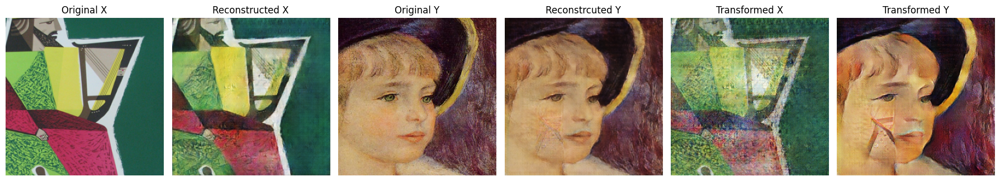

torch.Size([6, 3, 256, 256])


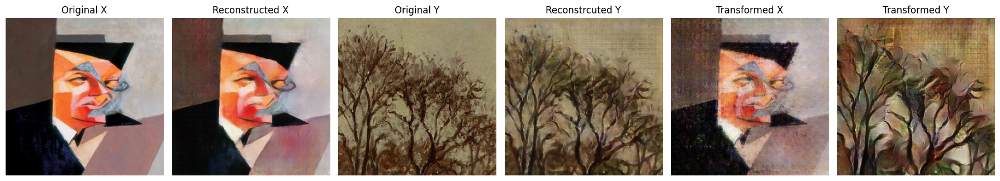

torch.Size([6, 3, 256, 256])


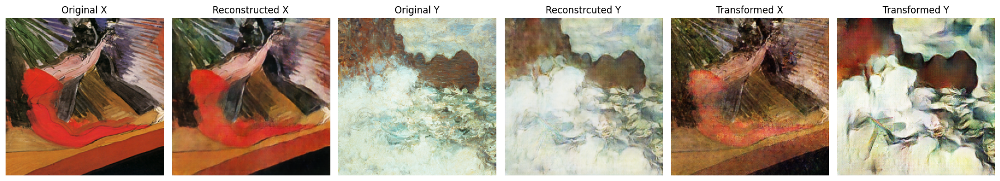

torch.Size([6, 3, 256, 256])


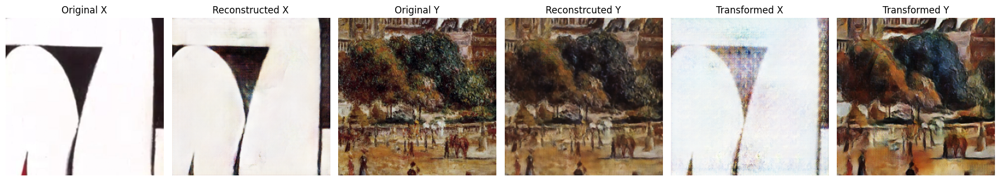

torch.Size([6, 3, 256, 256])


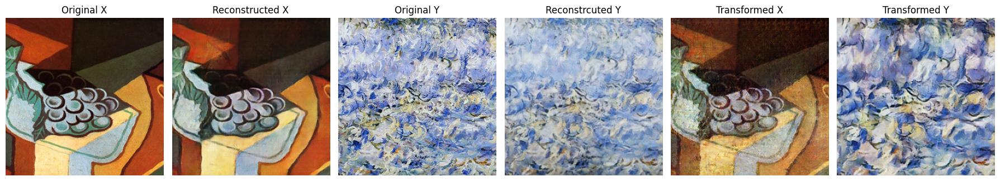

torch.Size([6, 3, 256, 256])


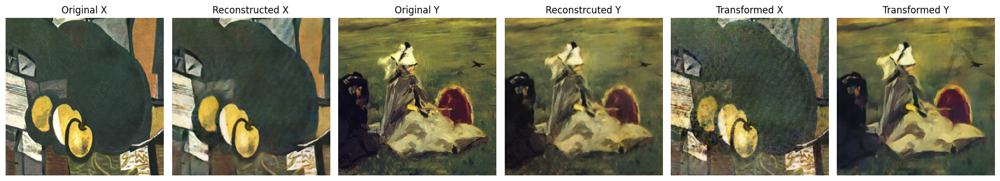

torch.Size([6, 3, 256, 256])


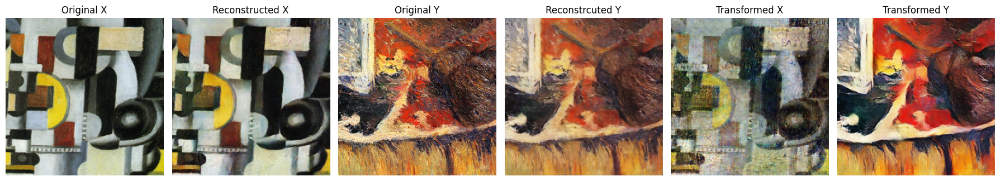

torch.Size([6, 3, 256, 256])


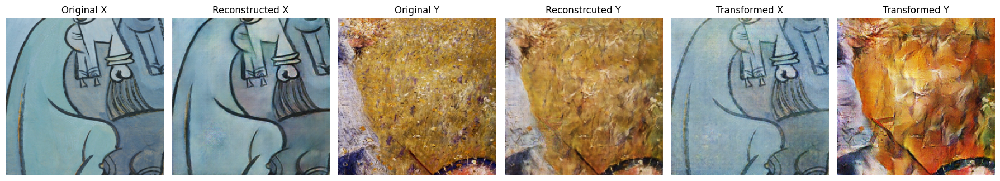

torch.Size([6, 3, 256, 256])


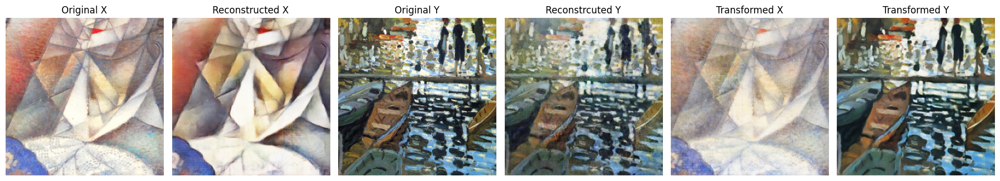

torch.Size([6, 3, 256, 256])


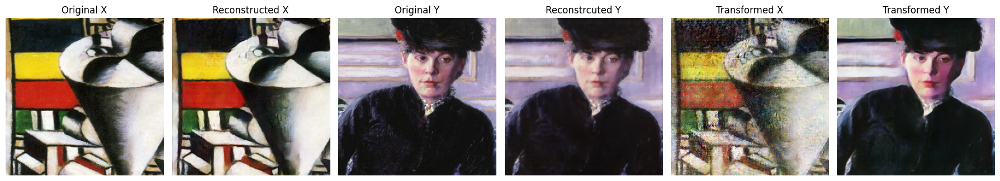

torch.Size([6, 3, 256, 256])


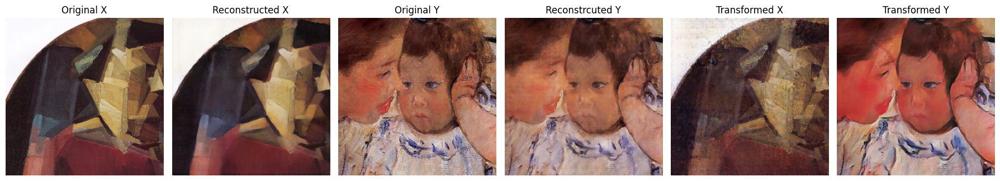

torch.Size([6, 3, 256, 256])


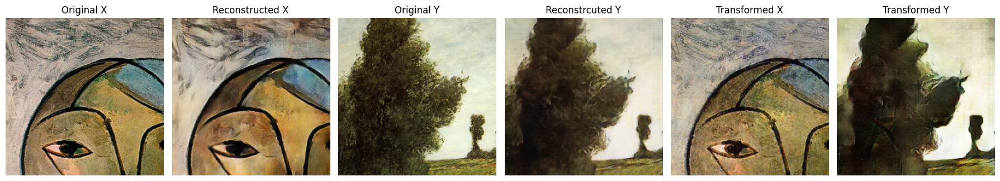

torch.Size([6, 3, 256, 256])


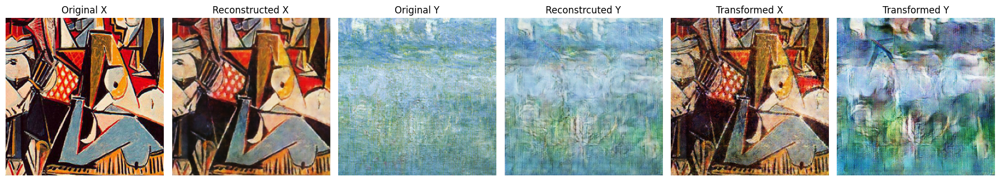

torch.Size([6, 3, 256, 256])


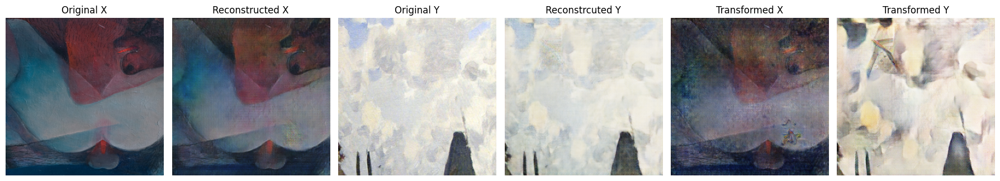

torch.Size([6, 3, 256, 256])


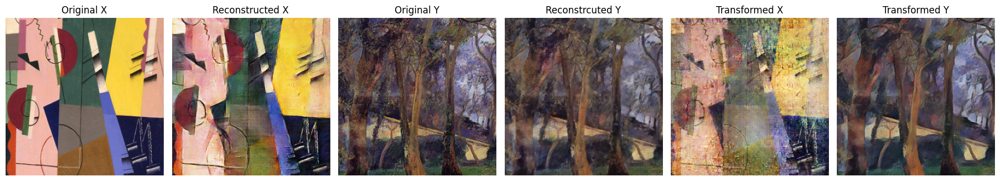

torch.Size([6, 3, 256, 256])


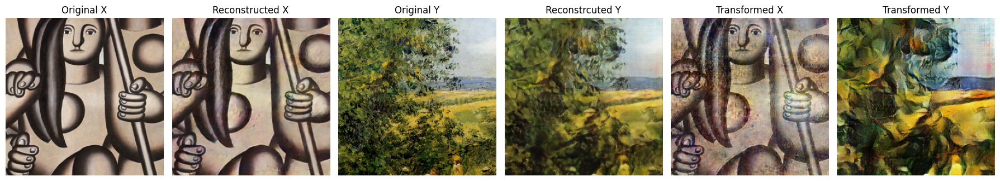

torch.Size([6, 3, 256, 256])


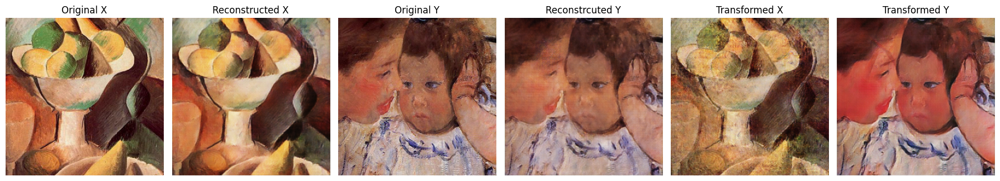

torch.Size([6, 3, 256, 256])


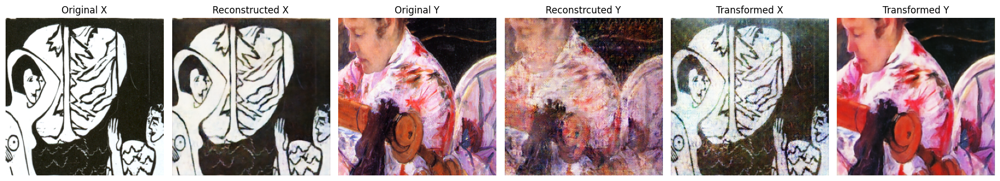

torch.Size([6, 3, 256, 256])


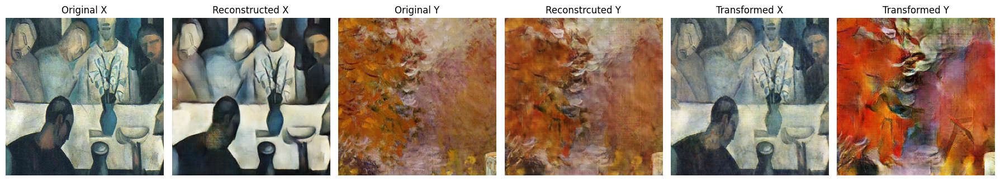

torch.Size([6, 3, 256, 256])


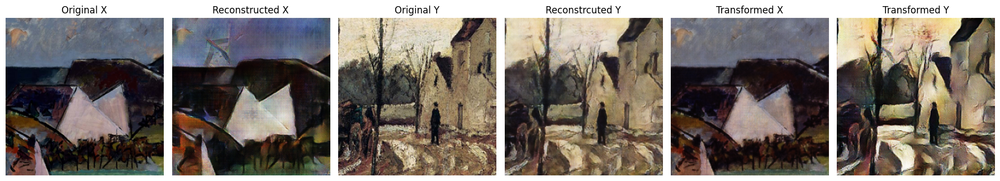

torch.Size([6, 3, 256, 256])


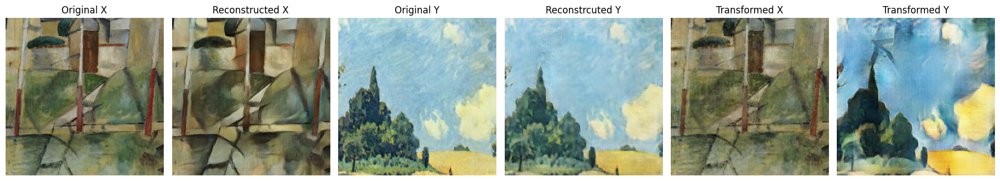

torch.Size([6, 3, 256, 256])


KeyboardInterrupt: 

In [27]:
if opt.mode == 'test':
    model.load_state_dict(torch.load("models_8/model_200.pth"))
    model.eval()

    test_loop = 4
    for j in range(test_loop):
        dataloader = torch.utils.data.DataLoader(dataset,batch_size=2,shuffle=not opt.serial_batches)
        for i, (real_X, real_Y) in enumerate(dataloader):

            #passing images as input to the model & calculate loss functions, get gradients, update network weights
            (fake_Y,fake_X, rec_X, rec_Y) = model.forward(real_X, real_Y)
            image_tensors = []
            for i in range(0,2):
                for img in (real_X[i], rec_X[i], real_Y[i], rec_Y[i], fake_Y[i], fake_X[i]):
                    if img.is_cuda:
                        img = img.cpu().detach()
                    else:
                        img = img.detach()
                    image_tensors.append(img.squeeze(0))
                stacked_image_tensor = torch.stack(image_tensors)
                print(stacked_image_tensor.shape)
                show_images(stacked_image_tensor)
                break
            
            

In [ ]:
if opt.mode == 'train':

    if opt.preprocess != 'scale_width':  # with [scale_width], input images might have different sizes, which hurts the performance of cudnn.benchmark.
        torch.backends.cudnn.benchmark = True

    for epoch in range(opt.epoch_count, opt.n_epochs + opt.n_epochs_decay + 1):
        epoch_start_time = time.time()  # timer for entire epoch
        iter_data_time = time.time()    # timer for data loading per iteration
        epoch_iter = 0                  # the number of training iterations in current epoch, reset to 0 every epoch
        total_iters = 0
        dataloader = torch.utils.data.DataLoader(dataset,batch_size=opt.batch_size,shuffle=not opt.serial_batches)
        #X = domain A image, Y = domain B image
        for i, (real_X, real_Y) in enumerate(dataloader):
            iter_start_time = time.time()  # timer for computation per iteration
            if total_iters % opt.print_freq == 0:
                t_data = iter_start_time - iter_data_time

            total_iters += opt.batch_size
            epoch_iter += opt.batch_size


            #passing images as input to the model & calculate loss functions, get gradients, update network weights
            (fake_Y,fake_X, rec_X, rec_Y) = model.train_step(real_X, real_Y)
            if total_iters % opt.print_freq == 0:    # print training losses
                losses = model.get_current_losses()
                t_comp = (time.time() - iter_start_time) / opt.batch_size
                print_current_losses(epoch, epoch_iter, losses, t_comp, t_data)
            iter_data_time = time.time()
        image_tensors = []
        for i in range(0,opt.batch_size):
            for img in (real_X[i], rec_X[i], real_Y[i], rec_Y[i], fake_Y[i], fake_X[i]):
                if img.is_cuda:
                    img = img.cpu().detach()
                else:
                    img = img.detach()
                image_tensors.append(img.squeeze(0))
            stacked_image_tensor = torch.stack(image_tensors)
            print(stacked_image_tensor.shape)
            show_images(stacked_image_tensor)
            break
        model.update_learning_rate()    # update learning rates at the end of every epoch.
        if(epoch%opt.save_freq ==0):
    #         torch.save(model.state_dict(),f"/kaggle/working/model_{epoch}.pth")
            torch.save(model.state_dict(),f"models_8/model_{epoch}.pth")

        print('End of epoch %d / %d \t Time Taken: %d sec' % (epoch, opt.n_epochs + opt.n_epochs_decay, time.time() - epoch_start_time))